<a href="https://colab.research.google.com/github/irfhanaz/lanedetopencv/blob/master/LaneDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pylab as plt
import cv2
import numpy as np

In [34]:
from IPython.display import Image
from IPython.display import display_pretty
from google.colab import files

In [ ]:
uploaded = files.upload()

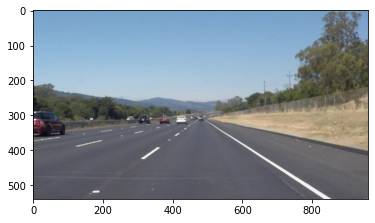

(540, 960, 3)


In [ ]:
image = cv2.imread('landetimg.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)
plt. show()

print(image.shape)
height = image.shape[0]
width = image.shape[1]

region_of_interest_vertices = [
    (0, height),
    (width/2, height/2),
    (width, height)
]

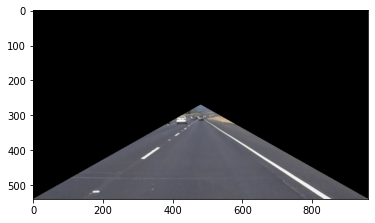

In [ ]:
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)
    channel_count = img.shape[2]
    match_mask_color = (255,) * channel_count
    cv2.fillPoly(mask, vertices, match_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

cropped_img = region_of_interest(image,
                np.array([region_of_interest_vertices], np.int32),)

plt.imshow(cropped_img)
plt.show()

In [ ]:
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)
    #channel_count = img.shape[2]
    match_mask_color = 255
    cv2.fillPoly(mask, vertices, match_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [ ]:
def draw_lines(img, lines):
    img = np.copy(img)
    blank = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)

    for line in lines:
        for x1, y1, x2, y2 in line:
            cv2.line(blank, (x1,y1), (x2,y2), (96, 237, 206), thickness=15)

    img = cv2.addWeighted(img, 0.7, blank, 1, 0.0)
    return img

In [ ]:
image = cv2.imread("landetimg.jpeg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(image.shape)
height = image.shape[0]
width = image.shape[1]
region_of_interest_vertices = [
    (0, height),
    (width/2, height/2),
    (width, height)
]

(540, 960, 3)


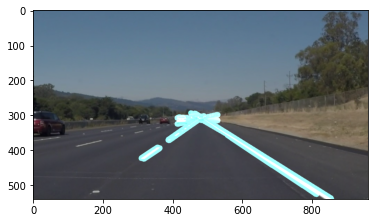

In [ ]:
gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
canny_image = cv2.Canny(gray_image, 100, 200)
cropped_image = region_of_interest(canny_image,
                np.array([region_of_interest_vertices], np.int32),)
lines = cv2.HoughLinesP(cropped_image,
                        rho=6,
                        theta=np.pi/180,
                        threshold=160,
                        lines=np.array([]),
                        minLineLength=40,
                        maxLineGap=25)
image_with_lines = draw_lines(image, lines)
plt.imshow(image_with_lines)
plt.show()

In [ ]:
def region_of_interest(img, vertices):
    mask = np.zeros_like(img)
    match_mask_color = 255
    cv2.fillPoly(mask, vertices, match_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


In [ ]:
def draw_lines(img, lines):
    img = np.copy(img)
    blank = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)

    for line in lines:
        for x1, y1, x2, y2 in line:
            cv2.line(blank, (x1,y1), (x2,y2), (96, 237, 206), thickness=8)

    img = cv2.addWeighted(img, 0.7, blank, 1, 0.0)
    return img

In [ ]:
def process(image):
    print(image.shape)
    height = image.shape[0]
    width = image.shape[1]
    region_of_interest_vertices = [
        (0, height),
        (width/2, height/2),
        (width, height)
    ]
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    canny_image = cv2.Canny(gray_image, 100, 120)
    cropped_image = region_of_interest(canny_image,
                    np.array([region_of_interest_vertices], np.int32),)
    lines = cv2.HoughLinesP(cropped_image,
                            rho=2,
                            theta=np.pi/180,
                            threshold=50,
                            lines=np.array([]),
                            minLineLength=40,
                            maxLineGap=100)
    image_with_lines = draw_lines(image, lines)
    return image_with_lines

In [ ]:
from google.colab.patches import cv2_imshow
uploaded = files.upload()

In [ ]:
cap = cv2.VideoCapture("test_video.mp4")
frame_list = []
while cap.isOpened():
    ret, frame = cap.read()
    if frame is None:
        break
    height, width, layers = frame.shape
    frame = process(frame)
    frame_list.append(frame)
    size = (width, height)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()

In [38]:
out = cv2.VideoWriter('output.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 20.0, size)
for i in range(len(frame_list)):
  out.write(frame_list[i])
out.release()
cv2.destroyAllWindows()


from moviepy.editor import *
video = VideoFileClip("output.mp4")
video.ipython_display(maxduration=70)



100%|█████████▉| 1295/1296 [00:18<00:00, 69.35it/s]
